<a href="https://colab.research.google.com/github/ersjunior/3DTS-MachineLearning/blob/main/ProjetoFinal_ML.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color=E91C5D size=6>Classificação de Credit Score</font>


##### <font size=2>INFORMAÇÕES DO TRABALHO</font>
##### <font size=2>3DTSR / MACHINE LEARNING / VINICIUS FERNANDES CARIDA</font>

Dado que vocês tem como Projeto Integrado o QuantumFinance, que enfrenta um problema de aumento da inadimplência entre seus clientes e busca uma solução para melhorar seu modelo de concessão de crédito, o trabalho dessa disciplina será aplicar os algoritmos aprendidos em um problema similar.
Usaremos essa competição/dados do Kaggle.
  * Base: https://www.kaggle.com/datasets/parisrohan/credit-score-classification

Essa é uma base de classificação de credit score e vocês tem acesso aos dados, alguns códigos e resultados. Trabalho:
  * 1-	Criar um modelo de classificação e aplicar na base e colher e explicar os resultados.
  * 2-	Criar um sistema especialista OU usar um algoritmo não supervisionado na base e falar da experiencia.

Trabalho precisa ser entregue até o inicio da ultima aula da disciplina, 31/08/2023 até as 19:00 para apresentar/discutirmos os resultados em aula. Na entrega no portal subir código e outros materiais em um arquivo zip.

## <font color=E91C5D><b>Part 1</b> - Criando um modelo de classificação e aplicando na base</font>

#### <font color=E91C5D>Importando as libs e acessando as bases de dados

In [1]:
# Importando as bibliotecas necessarias
import os
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.io as pio
import plotly.express as px
import scipy.stats as stats
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split,RandomizedSearchCV
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix


In [2]:
# Conectando com o Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### <font color=E91C5D>Informações dos recursos

* ID Representa uma identificação exclusiva de uma entrada

* Customer_ID Representa uma identificação exclusiva de uma pessoa

* Month Representa o mês do ano

* Name Representa o nome de uma pessoa

* Age Representa a idade da pessoa

* SSN Representa o número de segurança social de uma pessoa

* Occupation Representa a ocupação da pessoa

* Annual_Income Representa a renda anual da pessoa

* Monthly_Inhand_Salary Representa o salário base mensal de uma pessoa

* Num_Bank_Accounts Representa o número de contas bancárias que uma pessoa possui

* Num_Credit_Card Representa o número de outros cartões de crédito detidos por uma pessoa

* Interest_Rate Representa a taxa de juros do cartão de crédito

* Num_of_Loan Representa o número de empréstimos contraídos no banco

* Type_of_Loan Representa os tipos de empréstimo tomados por uma pessoa

* Delay_from_due_date Representa o número médio de dias de atraso desde a data de pagamento

* Num_of_Delayed_Payment Representa o número médio de pagamentos atrasados por uma pessoa

* Changed_Credit_Limit Representa a alteração percentual no limite do cartão de crédito

* Num_Credit_Inquiries Representa o número de consultas de cartão de crédito

* Credit_Mix Representa a classificação do mix de créditos

* Outstanding_Debt Representa a dívida restante a ser paga (em USD)

* Credit_Utilization_Ratio Representa a taxa de utilização do cartão de crédito

* Credit_History_Age Representa a idade do histórico de crédito da pessoa

* Payment_of_Min_Amount Representa se apenas o valor mínimo foi pago pela pessoa

* Total_EMI_per_month Representa os pagamentos mensais de EMI (em dólares americanos)

* Amount_invested_monthly Representa o valor mensal investido pelo cliente (em USD)

* Payment_Behaviour Representa o comportamento de pagamento do cliente (em USD)

* Monthly_Balance Representa o valor do saldo mensal do cliente (em USD)

* Credit_Score Representa a faixa de pontuação de crédito (ruim, padrão, bom)

### <font color=E91C5D>Entendimento dos dados

Fazendo perguntas básicas ao conjunto de dados, vamos entender os dados.

In [3]:
# Acessando base de treino
treino = pd.read_csv('/content/drive/MyDrive/ml_train.csv')
# Acessando base de teste
teste = pd.read_csv('/content/drive/MyDrive/ml_test.csv')

display(
treino.sample(1),
teste.sample(1)
)

<ipython-input-3-a2a955dfae42>:2: DtypeWarning: Columns (26) have mixed types. Specify dtype option on import or set low_memory=False.
  treino = pd.read_csv('/content/drive/MyDrive/ml_train.csv')


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
84457,0x204df,CUS_0x1c59,February,Dayz,41_,277-13-7658,Doctor,19188.055,1358.004583,5,...,Good,464.09,34.239588,22 Years and 3 Months,No,44.60237,162.41295612937068,!@9#%8,218.78513206133223,Good


,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
15779,0xceed,CUS_0xb108,December,Koh Guiv,38,888-27-8587,Musician,57449.79_,4907.4825,8,...,14.0,Bad,3990.44,35.008227,7 Years and 4 Months,Yes,278.904195,177.18329428284844,Low_spent_Small_value_payments,324.6607604168138


### <font color=E91C5D>Compreendendo e examinando o conjunto de dados de treino

In [4]:
# Corpo da base de treino
treino.shape, teste.shape

((100000, 28), (50000, 27))

In [5]:
# Dados da base de treino
treino.info(), teste.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

(None, None)

In [6]:
display(
    treino.isnull().mean()*100,
    teste.isnull().mean()*100
    )

ID                           0.000
Customer_ID                  0.000
Month                        0.000
Name                         9.985
Age                          0.000
SSN                          0.000
Occupation                   0.000
Annual_Income                0.000
Monthly_Inhand_Salary       15.002
Num_Bank_Accounts            0.000
Num_Credit_Card              0.000
Interest_Rate                0.000
Num_of_Loan                  0.000
Type_of_Loan                11.408
Delay_from_due_date          0.000
Num_of_Delayed_Payment       7.002
Changed_Credit_Limit         0.000
Num_Credit_Inquiries         1.965
Credit_Mix                   0.000
Outstanding_Debt             0.000
Credit_Utilization_Ratio     0.000
Credit_History_Age           9.030
Payment_of_Min_Amount        0.000
Total_EMI_per_month          0.000
Amount_invested_monthly      4.479
Payment_Behaviour            0.000
Monthly_Balance              1.200
Credit_Score                 0.000
dtype: float64

ID                           0.000
Customer_ID                  0.000
Month                        0.000
Name                        10.030
Age                          0.000
SSN                          0.000
Occupation                   0.000
Annual_Income                0.000
Monthly_Inhand_Salary       14.996
Num_Bank_Accounts            0.000
Num_Credit_Card              0.000
Interest_Rate                0.000
Num_of_Loan                  0.000
Type_of_Loan                11.408
Delay_from_due_date          0.000
Num_of_Delayed_Payment       6.996
Changed_Credit_Limit         0.000
Num_Credit_Inquiries         2.070
Credit_Mix                   0.000
Outstanding_Debt             0.000
Credit_Utilization_Ratio     0.000
Credit_History_Age           8.940
Payment_of_Min_Amount        0.000
Total_EMI_per_month          0.000
Amount_invested_monthly      4.542
Payment_Behaviour            0.000
Monthly_Balance              1.124
dtype: float64

### <font color=E91C5D>Vamos combinar dados de treinamento e teste

no cenário do mundo real, nunca combinaremos os dois dados porque isso leva ao vazamento de dados

In [7]:
# Ambos contém os mesmos recursos para que possamos concatena-los
treino.columns.tolist()[:-1] == teste.columns.tolist()

True

In [8]:
df=pd.concat([treino,teste],ignore_index=True)

In [9]:
# Verificando novo df
df.describe()

,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Delay_from_due_date,Num_Credit_Inquiries,Credit_Utilization_Ratio,Total_EMI_per_month
count,127500.000000,150000.000000,150000.000000,150000.000000,150000.000000,147000.000000,150000.000000,150000.000000
mean,4190.115139,17.006940,22.623447,71.234907,21.063400,28.529014,32.283309,1432.513579
std,3180.489657,117.069476,129.143006,461.537193,14.860154,194.456058,5.113315,8403.759977
min,303.645417,-1.000000,0.000000,1.000000,-5.000000,0.000000,20.000000,0.000000
25%,1625.265833,3.000000,4.000000,8.000000,10.000000,3.000000,28.054731,30.947775
50%,3091.000000,6.000000,5.000000,13.000000,18.000000,6.000000,32.297058,71.280006
75%,5948.454596,7.000000,7.000000,20.000000,28.000000,9.000000,36.487954,166.279555
max,15204.633333,1798.000000,1499.000000,5799.000000,67.000000,2597.000000,50.000000,82398.000000


In [10]:
df.describe(exclude=np.number).T

,count,unique,top,freq
ID,150000,150000,0x1602,1
Customer_ID,150000,12500,CUS_0xd40,12
Month,150000,12,January,12500
Name,135000,10139,Stevex,66
Age,150000,2524,39,4198
SSN,150000,12501,#F%$D@*&8,8400
Occupation,150000,16,_______,10500
Annual_Income,150000,21192,36585.12,24
Num_of_Loan,150000,623,3,21500
Type_of_Loan,132888,6260,Not Specified,2112


In [11]:
df.corr()

<ipython-input-11-2f6f6606aa2c>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Delay_from_due_date,Num_Credit_Inquiries,Credit_Utilization_Ratio,Total_EMI_per_month
Monthly_Inhand_Salary,1.000000,-0.012179,-0.004418,-0.009275,-0.249600,-0.007838,0.170601,0.011099
Num_Bank_Accounts,-0.012179,1.000000,0.001534,-0.001962,0.016774,-0.000176,-0.002591,-0.000095
Num_Credit_Card,-0.004418,0.001534,1.000000,-0.002670,0.009117,-0.002204,-0.001932,0.002231
Interest_Rate,-0.009275,-0.001962,-0.002670,1.000000,0.011016,-0.002887,-0.001023,0.003421
Delay_from_due_date,-0.249600,0.016774,0.009117,0.011016,1.000000,0.008334,-0.065657,-0.001490
Num_Credit_Inquiries,-0.007838,-0.000176,-0.002204,-0.002887,0.008334,1.000000,0.000077,-0.003014
Credit_Utilization_Ratio,0.170601,-0.002591,-0.001932,-0.001023,-0.065657,0.000077,1.000000,0.002137
Total_EMI_per_month,0.011099,-0.000095,0.002231,0.003421,-0.001490,-0.003014,0.002137,1.000000


### <font color=E91C5D>Engenharia de recursos

#### Limpeza de dados

In [12]:
# cramersV para encontrar relação entre os recursos
def cramersV(col) :
    contingency_table = pd.crosstab(df[col],df['Credit_Score'])
    chi2, p, dof, expected = chi2_contingency(contingency_table)

    num_rows, num_cols = contingency_table.shape
    n = contingency_table.sum().sum()
    V = (chi2 / (n * (min(num_rows, num_cols) - 1))) ** 0.5
    print( f" {col}s Cramér's V:  {V}")

In [13]:
cramersV('Month')

 Months Cramér's V:  0.03176517797785797


In [14]:
"""
Primeiro, não precisamos de nome, idade, ssn, ocupação e mês.
Também contém 9k de valores nulos, idade...
Acho que existe alguma relação entre idade e pontuação de crédito, SSN
"""
df.drop(axis=1,labels=['Name','Age','SSN','Month','Occupation'],inplace=True)
df.shape

(150000, 23)

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        150000 non-null  object 
 1   Customer_ID               150000 non-null  object 
 2   Annual_Income             150000 non-null  object 
 3   Monthly_Inhand_Salary     127500 non-null  float64
 4   Num_Bank_Accounts         150000 non-null  int64  
 5   Num_Credit_Card           150000 non-null  int64  
 6   Interest_Rate             150000 non-null  int64  
 7   Num_of_Loan               150000 non-null  object 
 8   Type_of_Loan              132888 non-null  object 
 9   Delay_from_due_date       150000 non-null  int64  
 10  Num_of_Delayed_Payment    139500 non-null  object 
 11  Changed_Credit_Limit      150000 non-null  object 
 12  Num_Credit_Inquiries      147000 non-null  float64
 13  Credit_Mix                150000 non-null  o

In [16]:
"""
Navegando no conjunto de dados vi que existem muitos valores estranhos
então primeiro vamos substituir todos eles
"""
def strange_values(col):
    df[col]=df[col].str.strip('_')
    df[col]=df[col].replace(['!@9#%8','', 'nan'],np.NaN)

In [17]:
cols=list(df.select_dtypes(include='O').columns)
list(map(strange_values,cols))

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [18]:
df.describe(exclude=np.number).T

,count,unique,top,freq
ID,150000,150000,0x1602,1
Customer_ID,150000,12500,CUS_0xd40,12
Annual_Income,150000,13988,109945.32,24
Num_of_Loan,150000,600,3,22618
Type_of_Loan,132888,6260,Not Specified,2112
Num_of_Delayed_Payment,139500,1014,19,8188
Changed_Credit_Limit,146850,4604,11.5,197
Credit_Mix,120000,3,Standard,54858
Outstanding_Debt,150000,12203,1109.03,36
Credit_History_Age,136500,408,17 Years and 11 Months,628


Agora parece bom

In [19]:
"""
Muitos recursos têm tipos de dados errados, então vamos corrigi-los
A função abaixo altera os tipos de dados
"""
def change_dtype(col,dtype):
    df[col]=df[col].astype(dtype)

In [20]:
required_features=[
    'Annual_Income',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Outstanding_Debt',
    'Amount_invested_monthly',
    'Monthly_Balance'
    ]
for col in required_features:
    change_dtype(col,'float64')

In [21]:
"""
Convertendo a idade do histórico de crédito para apenas o formato mensal
"""
def month_converter(x):
    if pd.notnull(x):
        num1 = int(x.split(' ')[0])
        num2 = int(x.split(' ')[3])

        return (num1*12)+num2
    else:
        return x

In [22]:
df['Credit_History_Age'] = df.Credit_History_Age.apply(lambda x: month_converter(x)).astype('float64')

#### Agora vamos lutar com valores nulos

In [23]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        150000 non-null  object 
 1   Customer_ID               150000 non-null  object 
 2   Annual_Income             150000 non-null  float64
 3   Monthly_Inhand_Salary     127500 non-null  float64
 4   Num_Bank_Accounts         150000 non-null  int64  
 5   Num_Credit_Card           150000 non-null  int64  
 6   Interest_Rate             150000 non-null  int64  
 7   Num_of_Loan               150000 non-null  float64
 8   Type_of_Loan              132888 non-null  object 
 9   Delay_from_due_date       150000 non-null  float64
 10  Num_of_Delayed_Payment    139500 non-null  float64
 11  Changed_Credit_Limit      146850 non-null  float64
 12  Num_Credit_Inquiries      147000 non-null  float64
 13  Credit_Mix                120000 non-null  o

In [24]:
df.groupby('Customer_ID')['Credit_Mix'].apply(list)[1]

['Standard',
 'Standard',
 'Standard',
 nan,
 nan,
 'Standard',
 'Standard',
 nan,
 'Standard',
 'Standard',
 'Standard',
 nan]

Podemos ver que agrupando o conjunto de dados por ID do cliente podemos substituir valores nulos pelos valores mais frequentes

In [25]:
temp=df.copy()

In [26]:
"""
Abaixo a função para agrupar o conjunto de dados pelo ID do cliente.
Substituimos os valores nulos pelo valor mais frequente na lista
"""
def null_replace_bymf(col):
    grouped=df.groupby('Customer_ID')[col]
    df[col]=grouped.transform(lambda x: x.fillna(stats.mode(x)[0][0]))

    print("befor number of null values : ",temp[col].isnull().sum())
    print("after number of null values : ",df[col].isnull().sum())

In [27]:
null_replace_bymf('Credit_Mix')

<ipython-input-26-2b5436a525a6>:7: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: x.fillna(stats.mode(x)[0][0]))
<ipython-input-26-2b5436a525a6>:7: DeprecationWarning: Support for non-numeric arrays has been deprecated as of SciPy 1.9.0 and will be removed in 1.11.0. `pandas.DataFrame.mode` can be used instead, see https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.mode.html.
  df[col]=grouped.transform(lambda x: x.fillna(stats.mode(x)[0][0]))


befor number of null values :  30000
after number of null values :  908


In [28]:
null_replace_bymf('Payment_Behaviour')

<ipython-input-26-2b5436a525a6>:7: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: x.fillna(stats.mode(x)[0][0]))
<ipython-input-26-2b5436a525a6>:7: DeprecationWarning: Support for non-numeric arrays has been deprecated as of SciPy 1.9.0 and will be removed in 1.11.0. `pandas.DataFrame.mode` can be used instead, see https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.mode.html.
  df[col]=grouped.transform(lambda x: x.fillna(stats.mode(x)[0][0]))


befor number of null values :  11400
after number of null values :  804


In [29]:
df['Type_of_Loan'].replace([np.nan], 'Not Specified', inplace=True)

Descobrimos que muitos dados contêm valores negativos que não são possíveis, portanto, substituiremos os valores negativos por nulos

In [30]:
# Função para substituir valores negativos por NaN
def replace_negatives(value):
    if isinstance(value, (int, float)):
        return value if value >= 0 else np.nan
    else:
        return value

In [31]:
df = df.applymap(replace_negatives)

Para recursos numéricos, primeiro limpamos os valores discrepantes, valores inesperados e valores nulos

In [32]:
df.isnull().sum()

ID                              0
Customer_ID                     0
Annual_Income                   0
Monthly_Inhand_Salary       22500
Num_Bank_Accounts              37
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                  5850
Type_of_Loan                    0
Delay_from_due_date           889
Num_of_Delayed_Payment      11431
Changed_Credit_Limit         5571
Num_Credit_Inquiries         3000
Credit_Mix                    908
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age          13500
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      6750
Payment_Behaviour             804
Monthly_Balance              3445
Credit_Score                50000
dtype: int64

In [33]:
num_features=list(df.select_dtypes(exclude='O').columns)
num_features

['Annual_Income',
 'Monthly_Inhand_Salary',
 'Num_Bank_Accounts',
 'Num_Credit_Card',
 'Interest_Rate',
 'Num_of_Loan',
 'Delay_from_due_date',
 'Num_of_Delayed_Payment',
 'Changed_Credit_Limit',
 'Num_Credit_Inquiries',
 'Outstanding_Debt',
 'Credit_Utilization_Ratio',
 'Credit_History_Age',
 'Total_EMI_per_month',
 'Amount_invested_monthly',
 'Monthly_Balance']

In [34]:
temp=df.copy()

In [35]:
"""
Abaixo a função que agrupa o conjunto de dados pelo ID do cliente e
substitui os valores discrepantes, inesperados e nulos
pelo valor mais frequente na lista
"""
def mode_replace_outliers_values(col):
    grouped=df.groupby('Customer_ID')[col]
    df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])
    print(f"for {col}")
    print(f"befor max value : {temp[col].max()}")
    print(f"befor min value : {temp[col].min()}")
    print(f"before null values : {temp[col].isnull().sum()}")
    print(f"after max value : {df[col].max()} ")
    print(f"after min value : {df[col].min()}")
    print(f"after null values : {df[col].isnull().sum()}")

    print()
    print()

In [36]:
for col in num_features:
    mode_replace_outliers_values(col)

<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Annual_Income
befor max value : 24198062.0
befor min value : 7005.93
before null values : 0
after max value : 179987.28 
after min value : 7005.93
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Monthly_Inhand_Salary
befor max value : 15204.633333333331
befor min value : 303.6454166666666
before null values : 22500
after max value : 15204.633333333331 
after min value : 303.6454166666666
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Num_Bank_Accounts
befor max value : 1798.0
befor min value : 0.0
before null values : 37
after max value : 11.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Num_Credit_Card
befor max value : 1499
befor min value : 0
before null values : 0
after max value : 11 
after min value : 0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Interest_Rate
befor max value : 5799
befor min value : 1
before null values : 0
after max value : 34 
after min value : 1
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Num_of_Loan
befor max value : 1496.0
befor min value : 0.0
before null values : 5850
after max value : 9.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Delay_from_due_date
befor max value : 67.0
befor min value : 0.0
before null values : 889
after max value : 62.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Num_of_Delayed_Payment
befor max value : 4399.0
befor min value : 0.0
before null values : 11431
after max value : 25.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Changed_Credit_Limit
befor max value : 36.97
befor min value : 0.0
before null values : 5571
after max value : 29.98 
after min value : 0.5
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Num_Credit_Inquiries
befor max value : 2597.0
befor min value : 0.0
before null values : 3000
after max value : 17.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Outstanding_Debt
befor max value : 4998.07
befor min value : 0.23
before null values : 0
after max value : 4998.07 
after min value : 0.23
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Credit_Utilization_Ratio
befor max value : 50.00000000000001
befor min value : 20.0
before null values : 0
after max value : 35.79303827374269 
after min value : 20.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Credit_History_Age
befor max value : 408.0
befor min value : 1.0
before null values : 13500
after max value : 397.0 
after min value : 1.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Total_EMI_per_month
befor max value : 82398.0
befor min value : 0.0
before null values : 0
after max value : 1779.1032538262775 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Amount_invested_monthly
befor max value : 10000.0
befor min value : 0.0
before null values : 6750
after max value : 10000.0 
after min value : 0.0
after null values : 0




<ipython-input-35-649470d910a2>:8: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  df[col]=grouped.transform(lambda x: stats.mode(x,nan_policy='omit')[0][0])


for Monthly_Balance
befor max value : 1606.5181919814756
befor min value : 0.007759664775335295
before null values : 3445
after max value : 1183.9306960885192 
after min value : 0.007759664775335295
after null values : 0




Agora, agrupando os dados por customerid e substituindo todos os valores pelo valor do modo, removemos os valores inesperados, também substituímos os valores nulos pela maioria dos valores do modo e agora temos zero valores nulos em todo o nosso conjunto de dados.

In [37]:
df.isnull().sum()

ID                              0
Customer_ID                     0
Annual_Income                   0
Monthly_Inhand_Salary           0
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                    0
Delay_from_due_date             0
Num_of_Delayed_Payment          0
Changed_Credit_Limit            0
Num_Credit_Inquiries            0
Credit_Mix                    908
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age              0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly         0
Payment_Behaviour             804
Monthly_Balance                 0
Credit_Score                50000
dtype: int64

#### Vamos tornar interativo

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        150000 non-null  object 
 1   Customer_ID               150000 non-null  object 
 2   Annual_Income             150000 non-null  float64
 3   Monthly_Inhand_Salary     150000 non-null  float64
 4   Num_Bank_Accounts         150000 non-null  float64
 5   Num_Credit_Card           150000 non-null  int64  
 6   Interest_Rate             150000 non-null  int64  
 7   Num_of_Loan               150000 non-null  float64
 8   Type_of_Loan              150000 non-null  object 
 9   Delay_from_due_date       150000 non-null  float64
 10  Num_of_Delayed_Payment    150000 non-null  float64
 11  Changed_Credit_Limit      150000 non-null  float64
 12  Num_Credit_Inquiries      150000 non-null  float64
 13  Credit_Mix                149092 non-null  o

In [39]:
df.columns

Index(['ID', 'Customer_ID', 'Annual_Income', 'Monthly_Inhand_Salary',
       'Num_Bank_Accounts', 'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan',
       'Type_of_Loan', 'Delay_from_due_date', 'Num_of_Delayed_Payment',
       'Changed_Credit_Limit', 'Num_Credit_Inquiries', 'Credit_Mix',
       'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score'],
      dtype='object')

podemos ver claramente que uma pessoa com cartões de crédito altos tem uma pontuação de crédito ruim e vice-versa

In [40]:
col=[
    'Monthly_Inhand_Salary',
    'Num_Bank_Accounts',
    'Num_Credit_Card',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Changed_Credit_Limit',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    'Credit_Utilization_Ratio',
    'Credit_History_Age',
    'Total_EMI_per_month',
    'Amount_invested_monthly',
    'Monthly_Balance'
    ]
for col in col:
    fig=px.histogram(
        df,x='Credit_Score',
        y=col,histfunc='avg',
        title=f"Relação entre score de crédiro e {col}"
        )
    fig.show()

#### Observações!!!

<b>Com o aumento dos recursos abaixo, a pontuação de crédito também está aumentando</b>

1.  Monthly_Inhand_Salary
2.  Credit_History_Age
3.  Monthly_Balance

<b>Com o aumento dos recursos abaixo, a pontuação de crédito está diminuindo</b>

1.  Num_Bank_Accounts
2.  Interest_Rate
3.  Num_of_Loan
4.  Delay_from_due_date
5.  Num_of_Delayed_Payment
6.  Num_Credit_Inquiries
7.  Outstanding_Debt



In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        150000 non-null  object 
 1   Customer_ID               150000 non-null  object 
 2   Annual_Income             150000 non-null  float64
 3   Monthly_Inhand_Salary     150000 non-null  float64
 4   Num_Bank_Accounts         150000 non-null  float64
 5   Num_Credit_Card           150000 non-null  int64  
 6   Interest_Rate             150000 non-null  int64  
 7   Num_of_Loan               150000 non-null  float64
 8   Type_of_Loan              150000 non-null  object 
 9   Delay_from_due_date       150000 non-null  float64
 10  Num_of_Delayed_Payment    150000 non-null  float64
 11  Changed_Credit_Limit      150000 non-null  float64
 12  Num_Credit_Inquiries      150000 non-null  float64
 13  Credit_Mix                149092 non-null  o

In [42]:
df['Credit_Mix'].value_counts()

Standard    68329
Good        45301
Bad         35462
Name: Credit_Mix, dtype: int64

### <font color=E91C5D>Codificando os recursos categóricos

In [43]:
encoding_variables=[
    'Type_of_Loan',
    'Credit_Mix',
    'Payment_of_Min_Amount',
    'Payment_Behaviour'
]

A função abaixo usa codificação de frequência

In [44]:
def frequency_encoding(df, column):
    freq_map = df[column].value_counts(normalize=True).to_dict()
    df[column + '_freq_enc'] = df[column].map(freq_map)

In [45]:
for column in encoding_variables:
    frequency_encoding(df, column)

In [46]:
df['Type_of_Loan']=df['Type_of_Loan_freq_enc']
df['Credit_Mix']=df['Credit_Mix_freq_enc']
df['Payment_of_Min_Amount']=df['Payment_of_Min_Amount_freq_enc']
df['Payment_Behaviour']=df['Payment_Behaviour_freq_enc']

In [47]:
df.drop(
    columns=[
        'Type_of_Loan_freq_enc',
        'Credit_Mix_freq_enc',
        'Payment_of_Min_Amount_freq_enc',
        'Payment_Behaviour_freq_enc'
        ],
    inplace=True
  )

In [48]:
df.sample(5)

,ID,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
22245,0x9857,CUS_0xac2b,15723.705,1191.308750,7.0,3,6,4.0,0.00016,8.0,...,0.458301,632.13,26.815250,233.0,0.356773,29.313068,10000.000000,0.145775,221.863506,Standard
36297,0xeaaf,CUS_0x97fc,80953.200,6722.100000,6.0,3,8,2.0,0.00192,16.0,...,0.458301,597.32,27.445351,271.0,0.523227,111.728796,48.537185,0.193303,167.512480,Standard
75427,0x1cff5,CUS_0x1a3a,48948.570,3845.047500,5.0,7,9,6.0,0.00008,13.0,...,0.458301,2414.79,25.664961,176.0,0.523227,157.781813,44.076779,0.118388,127.675934,Standard
145245,0x2283f,CUS_0x2c2b,7252.065,530.338750,7.0,5,24,3.0,0.00032,23.0,...,0.237853,1345.66,23.846964,208.0,0.523227,16.282733,0.000000,0.284270,257.145863,NaN
10553,0x53d7,CUS_0xa98a,33177.950,2891.829167,5.0,4,17,4.0,0.00024,21.0,...,0.458301,261.12,23.843336,316.0,0.356773,61.099413,20.136052,0.284270,139.505917,Standard


In [49]:
df.isnull().sum()

ID                              0
Customer_ID                     0
Annual_Income                   0
Monthly_Inhand_Salary           0
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                    0
Delay_from_due_date             0
Num_of_Delayed_Payment          0
Changed_Credit_Limit            0
Num_Credit_Inquiries            0
Credit_Mix                    908
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age              0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly         0
Payment_Behaviour             804
Monthly_Balance                 0
Credit_Score                50000
dtype: int64

#### Agora nosso conjunto de dados está pronto para previsão

Primeiro dividimos nosso conjunto de dados em conjunto de dados de treinamento e teste

In [50]:
train_df=df.iloc[:100000]
test_df=df.iloc[100000:]

In [51]:
train_df.sample(5)

,ID,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
22435,0x9975,CUS_0x55f1,9898.600,862.883333,6.0,8,20,5.0,0.00008,29.0,...,0.237853,1302.29,25.214481,79.0,0.523227,40.662656,31.814325,0.284270,229.412160,Poor
61367,0x17d91,CUS_0x5a9e,28647.750,2161.312500,5.0,6,5,5.0,0.00008,5.0,...,0.458301,82.60,24.744829,71.0,0.523227,113.192315,27.409411,0.149233,143.266492,Good
85550,0x20b44,CUS_0x1123,15264.980,1266.081667,6.0,5,34,3.0,0.00016,26.0,...,0.237853,2375.88,24.094344,99.0,0.523227,36.790097,23.309900,0.284270,213.241985,Poor
89793,0x22423,CUS_0xa4e7,17481.785,1736.815417,4.0,6,5,2.0,0.00168,15.0,...,0.303846,1148.28,22.987478,290.0,0.356773,18.079812,13.353074,0.149233,277.075267,Good
60701,0x179ab,CUS_0xafd1,17692.260,1380.355000,5.0,6,21,6.0,0.00008,16.0,...,0.458301,1467.79,22.288596,177.0,0.523227,73.938178,42.694839,0.109031,197.700486,Poor


In [52]:
test_df.drop(columns='Credit_Score',inplace=True)

<ipython-input-52-0e0cecbebadf>:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [53]:
test_df.sample(5)

,ID,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,...,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
111621,0x9e37,CUS_0x7307,17157.470,1656.789167,10.0,7,22,6.0,0.00008,49.0,...,11.0,0.237853,3743.28,24.342114,128.0,0.523227,44.451575,16.367375,0.284270,210.186133
135668,0x1b806,CUS_0x31ce,16864.180,1474.348333,5.0,4,18,4.0,0.00008,24.0,...,6.0,0.458301,262.98,23.412159,290.0,0.523227,44.271842,42.086131,0.145775,211.510956
126752,0x14f8a,CUS_0xbecb,8514.715,525.559583,10.0,7,22,6.0,0.00008,21.0,...,11.0,0.237853,4403.86,24.671775,105.0,0.523227,21.483307,10000.000000,0.284270,258.360452
108556,0x7a4e,CUS_0xa6df,75888.640,6089.731592,3.0,6,11,6.0,0.00008,16.0,...,7.0,0.458301,1149.63,23.500604,98.0,0.523227,819.045835,57.666520,0.149233,29.208692
142485,0x207e7,CUS_0x282b,63839.240,5192.936667,7.0,6,14,3.0,0.00048,30.0,...,7.0,0.458301,2695.33,24.487027,195.0,0.523227,144.709626,10000.000000,0.193303,408.185547


In [54]:
print(train_df.isnull().sum())
print(test_df.isnull().sum())

ID                            0
Customer_ID                   0
Annual_Income                 0
Monthly_Inhand_Salary         0
Num_Bank_Accounts             0
Num_Credit_Card               0
Interest_Rate                 0
Num_of_Loan                   0
Type_of_Loan                  0
Delay_from_due_date           0
Num_of_Delayed_Payment        0
Changed_Credit_Limit          0
Num_Credit_Inquiries          0
Credit_Mix                  620
Outstanding_Debt              0
Credit_Utilization_Ratio      0
Credit_History_Age            0
Payment_of_Min_Amount         0
Total_EMI_per_month           0
Amount_invested_monthly       0
Payment_Behaviour           571
Monthly_Balance               0
Credit_Score                  0
dtype: int64
ID                            0
Customer_ID                   0
Annual_Income                 0
Monthly_Inhand_Salary         0
Num_Bank_Accounts             0
Num_Credit_Card               0
Interest_Rate                 0
Num_of_Loan                

In [55]:
print(train_df.Credit_Mix.mean())
print(train_df.Payment_Behaviour.mean())

print(test_df.Credit_Mix.mean())
print(test_df.Payment_Behaviour.mean())

0.3589290791353796
0.187666866892775
0.35895044580276614
0.18746604101249253


In [56]:
# Removendo todos os nulos e substituindo pela média
train_df['Credit_Mix'].fillna(train_df.Credit_Mix.mean(), inplace=True)
train_df['Payment_Behaviour'].fillna(train_df.Credit_Mix.mean(), inplace=True)
print(train_df.isnull().sum())

test_df['Credit_Mix'].fillna(test_df.Credit_Mix.mean(), inplace=True)
test_df['Payment_Behaviour'].fillna(test_df.Credit_Mix.mean(), inplace=True)
print(test_df.isnull().sum())

ID                          0
Customer_ID                 0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Type_of_Loan                0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Changed_Credit_Limit        0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Credit_History_Age          0
Payment_of_Min_Amount       0
Total_EMI_per_month         0
Amount_invested_monthly     0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
dtype: int64
ID                          0
Customer_ID                 0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Type_of_Loan                0
Delay_from_due_date        

<ipython-input-56-b30b0881ff21>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-56-b30b0881ff21>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-56-b30b0881ff21>:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-56-b30b0881ff21>:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pand

#### Vamos fazer previsão

Previsão da célula abaixo com ajuste de hiperparâmetros.

In [57]:
"""
Carregamos nosso conjunto de dados e dividimos em
recursos (X) e destino (y)
"""
X = train_df.drop(
    columns=[
        'Credit_Score',
        'ID',
        'Customer_ID',
        'Changed_Credit_Limit',
        'Credit_Utilization_Ratio'
        ]
    )
y = train_df['Credit_Score']

X_train, X_test, y_train, y_test = train_test_split(
    X,
    y,
    test_size=0.2,
    random_state=42
    )

"""
Inicializando o classificador Random Forest
"""
rf_classifier = RandomForestClassifier(
    n_estimators=100,
    random_state=42,
    max_depth=20,
    min_samples_split=10,
    min_samples_leaf=7
    )

"""
Treinando o classificador
"""
rf_classifier.fit(X_train, y_train)

"""
Prevendo a variável alvo no conjunto de teste
"""
y_pred = rf_classifier.predict(X_test)

"""
Avaliando o desempenho
"""
accuracy = accuracy_score(y_test, y_pred)
confusion_mat = confusion_matrix(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

"""
Mostrando as métricas de avaliação
"""
print("Precisão:", accuracy)
print("Matriz de confusão:\n", confusion_mat)
print("Relatório de classificação:\n", classification_rep)

Precisão: 0.8053
Matriz de confusão:
 [[2709    4  814]
 [  91 4791  992]
 [ 789 1204 8606]]
Relatório de classificação:
               precision    recall  f1-score   support

        Good       0.75      0.77      0.76      3527
        Poor       0.80      0.82      0.81      5874
    Standard       0.83      0.81      0.82     10599

    accuracy                           0.81     20000
   macro avg       0.79      0.80      0.80     20000
weighted avg       0.81      0.81      0.81     20000



## <font color=E91C5D><b>Part 2</b> - Criando um sistema especialista ou usando um algoritmo não supervisionado na base e falar da experiencia.

### <font color=E91C5D><b>Sistema Especialista

Com o aumento dos recursos abaixo, a pontuação de crédito também está aumentando

* Monthly_Inhand_Salary
* Credit_History_Age
* Monthly_Balance

Com o aumento dos recursos abaixo, a pontuação de crédito está diminuindo

* Num_Bank_Accounts
* Interest_Rate
* Num_of_Loan
* Delay_from_due_date
* Num_of_Delayed_Payment
* Num_Credit_Inquiries
* Outstanding_Debt

In [58]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 23 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Annual_Income             100000 non-null  float64
 3   Monthly_Inhand_Salary     100000 non-null  float64
 4   Num_Bank_Accounts         100000 non-null  float64
 5   Num_Credit_Card           100000 non-null  int64  
 6   Interest_Rate             100000 non-null  int64  
 7   Num_of_Loan               100000 non-null  float64
 8   Type_of_Loan              100000 non-null  float64
 9   Delay_from_due_date       100000 non-null  float64
 10  Num_of_Delayed_Payment    100000 non-null  float64
 11  Changed_Credit_Limit      100000 non-null  float64
 12  Num_Credit_Inquiries      100000 non-null  float64
 13  Credit_Mix                100000 non-null  fl

In [59]:
train_df.describe()

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,50505.123449,4191.345940,5.367440,5.532240,14.53208,3.532880,0.018010,21.061440,13.30304,10.395543,6.187920,0.358929,1426.220376,24.720310,217.80528,0.415442,112.087769,991.915971,0.188645,203.720061
std,38299.422093,3181.878502,2.593132,2.068324,8.74133,2.446356,0.042377,14.762033,6.18939,6.510166,3.941203,0.094226,1155.129026,1.759498,99.65587,0.133369,141.649393,2905.896192,0.067287,102.201424
min,7005.930000,303.645417,0.000000,0.000000,1.00000,0.000000,0.000080,0.000000,0.00000,0.500000,0.000000,0.237853,0.230000,20.000000,1.00000,0.120000,0.000000,0.000000,0.109031,0.007760
25%,19342.972500,1625.588021,3.000000,4.000000,7.00000,2.000000,0.000080,10.000000,9.00000,5.500000,3.000000,0.303846,566.072500,23.455653,141.00000,0.356773,29.784265,29.458630,0.145775,145.301890
50%,36999.705000,3089.149167,5.000000,5.000000,13.00000,3.000000,0.000240,18.000000,14.00000,9.340000,6.000000,0.303846,1166.155000,24.479716,216.00000,0.523227,67.712225,49.038952,0.149233,208.915642
75%,71683.470000,5950.535833,7.000000,7.000000,20.00000,5.000000,0.002320,28.000000,18.00000,14.670000,9.000000,0.458301,1945.962500,25.687274,298.00000,0.523227,151.290071,84.378420,0.284270,251.062315
max,179987.280000,15204.633333,11.000000,11.000000,34.00000,9.000000,0.128160,62.000000,25.00000,29.980000,17.000000,0.458301,4998.070000,35.793038,397.00000,0.523227,1779.103254,10000.000000,0.358929,1183.930696


In [60]:
train_df.loc[train_df['Credit_Score'] == 'Good'].head()

,ID,Customer_ID,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,19114.12,1824.843333,3.0,4,3,4.0,0.00008,3.0,...,0.303846,809.98,22.537593,265.0,0.356773,49.574949,21.46538,0.118388,186.266702,Good
1,0x1603,CUS_0xd40,19114.12,1824.843333,3.0,4,3,4.0,0.00008,3.0,...,0.303846,809.98,22.537593,265.0,0.356773,49.574949,21.46538,0.109031,186.266702,Good
2,0x1604,CUS_0xd40,19114.12,1824.843333,3.0,4,3,4.0,0.00008,3.0,...,0.303846,809.98,22.537593,265.0,0.356773,49.574949,21.46538,0.145775,186.266702,Good
3,0x1605,CUS_0xd40,19114.12,1824.843333,3.0,4,3,4.0,0.00008,3.0,...,0.303846,809.98,22.537593,265.0,0.356773,49.574949,21.46538,0.284270,186.266702,Good
4,0x1606,CUS_0xd40,19114.12,1824.843333,3.0,4,3,4.0,0.00008,3.0,...,0.303846,809.98,22.537593,265.0,0.356773,49.574949,21.46538,0.193303,186.266702,Good


#### Definir o Conhecimento do Domínio

In [61]:
conhecimento = {
    'Monthly_Inhand_Salary': {
        'Alta': np.percentile(train_df['Monthly_Inhand_Salary'], 75),
        'Média':  train_df['Monthly_Inhand_Salary'].mean(),
        'Baixa': np.percentile(train_df['Monthly_Inhand_Salary'], 25),
    },
    'Credit_History_Age': {
        'Alta': np.percentile(train_df['Credit_History_Age'], 75),
        'Média': train_df['Credit_History_Age'].mean(),
        'Baixa': np.percentile(train_df['Credit_History_Age'], 25),
    },
    'Monthly_Balance': {
        'Alta': np.percentile(train_df['Monthly_Balance'], 75),
        'Média': train_df['Monthly_Balance'].mean(),
        'Baixa': np.percentile(train_df['Monthly_Balance'], 25),
    },
    'Outstanding_Debt': {
        'Alta': np.percentile(train_df['Outstanding_Debt'], 75),
        'Média': train_df['Outstanding_Debt'].mean(),
        'Baixa': np.percentile(train_df['Outstanding_Debt'], 25),
    },
    'Num_Bank_Accounts': {
        'Alta': np.percentile(train_df['Num_Bank_Accounts'], 75),
        'Média': train_df['Num_Bank_Accounts'].mean(),
        'Baixas': np.percentile(train_df['Num_Bank_Accounts'], 25),
    },
    'Interest_Rate': {
        'Alta': np.percentile(train_df['Interest_Rate'], 75),
        'Média': train_df['Interest_Rate'].mean(),
        'Baixa': np.percentile(train_df['Interest_Rate'], 25),
    },
    'Num_of_Loan': {
        'Alta': np.percentile(train_df['Num_of_Loan'], 75),
        'Média': train_df['Num_of_Loan'].mean(),
        'Baixa': np.percentile(train_df['Num_of_Loan'], 25),
    },
    'Delay_from_due_date': {
        'Alta': np.percentile(train_df['Delay_from_due_date'], 75),
        'Média': train_df['Delay_from_due_date'].mean(),
        'Baixa': np.percentile(train_df['Delay_from_due_date'], 25),
    },
    'Num_of_Delayed_Payment': {
        'Alta': np.percentile(train_df['Num_of_Delayed_Payment'], 75),
        'Média': train_df['Num_of_Delayed_Payment'].mean(),
        'Baixa': np.percentile(train_df['Num_of_Delayed_Payment'], 25),
    },
    'Num_Credit_Inquiries':{
        'Alta': np.percentile(train_df['Num_Credit_Inquiries'], 75),
        'Média': train_df['Num_Credit_Inquiries'].mean(),
        'Baixa': np.percentile(train_df['Num_Credit_Inquiries'], 25),
    },
}

#### Criar uma Função de Avaliação

In [62]:
def calcular_score_credito(dados_cliente):
    score = 0
    for caracteristica, valor in dados_cliente.items():
        if caracteristica in conhecimento:
            # print(f'Característica: {caracteristica}, Valor: {valor}')
            score += valor  # Soma diretamente o valor numérico
    return score

In [63]:
id_cli = '0x1603'

dados_cliente = {
    'Monthly_Inhand_Salary': train_df.loc[train_df['ID'] == id_cli, ['Monthly_Inhand_Salary']].values[0],
    'Credit_History_Age': train_df.loc[train_df['ID'] == id_cli, ['Credit_History_Age']].values[0],
    'Monthly_Balance': train_df.loc[train_df['ID'] == id_cli, ['Monthly_Balance']].values[0],
    'Outstanding_Debt': train_df.loc[train_df['ID'] == id_cli, ['Outstanding_Debt']].values[0],
    'Num_Bank_Accounts': train_df.loc[train_df['ID'] == id_cli, ['Num_Bank_Accounts']].values[0],
    'Interest_Rate': train_df.loc[train_df['ID'] == id_cli, ['Interest_Rate']].values[0],
    'Num_of_Loan': train_df.loc[train_df['ID'] == id_cli, ['Num_of_Loan']].values[0],
    'Delay_from_due_date': train_df.loc[train_df['ID'] == id_cli, ['Delay_from_due_date']].values[0],
    'Num_of_Delayed_Payment': train_df.loc[train_df['ID'] == id_cli, ['Num_of_Delayed_Payment']].values[0],
    'Num_Credit_Inquiries': train_df.loc[train_df['ID'] == id_cli, ['Num_Credit_Inquiries']].values[0],
}

calcular_score_credito(dados_cliente)

array([3107.09003542])

#### Tomar uma Decisão de Concessão de Crédito

In [64]:
limite_aprovacao = 3000

def aprovar_credito(dados_cliente):
    score = calcular_score_credito(dados_cliente)
    if score >= limite_aprovacao:
        return "Aprovado"
    else:
        return "Negado"

#### Testar o Sistema Especialista

In [65]:
# Calcula o score de crédito
score_credito = calcular_score_credito(dados_cliente)

In [66]:
# Exibe o resultado
print("Score de Crédito:", score_credito)

Score de Crédito: [3107.09003542]


In [67]:
decisao = aprovar_credito(dados_cliente)
print("Decisão de Crédito:", decisao)

Decisão de Crédito: Aprovado


### <font color=E91C5D><b>Algoritimo de aprendizagem não supervisionado (k-Means)

Importar bibliotecas e carregar dados

Monthly_Inhand_Salary,
Credit_History_Age,
Monthly_Balance,
Num_Bank_Accounts,
Interest_Rate,
Num_of_Loan,
Delay_from_due_date,
Num_of_Delayed_Payment,
Num_Credit_Inquiries,
Outstanding_Debt,

In [68]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Carregar dados
data = test_df
# Recursos
X = data[
    [
    'Monthly_Inhand_Salary',
    'Credit_History_Age',
    'Monthly_Balance',
    'Num_Bank_Accounts',
    'Interest_Rate',
    'Num_of_Loan',
    'Delay_from_due_date',
    'Num_of_Delayed_Payment',
    'Num_Credit_Inquiries',
    'Outstanding_Debt',
    ]
]

Treinar o modelo K-Means

In [69]:
kmeans = KMeans(n_clusters=3)  # Suponha 3 clusters
kmeans.fit(X)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=3)

Visualizar os clusters

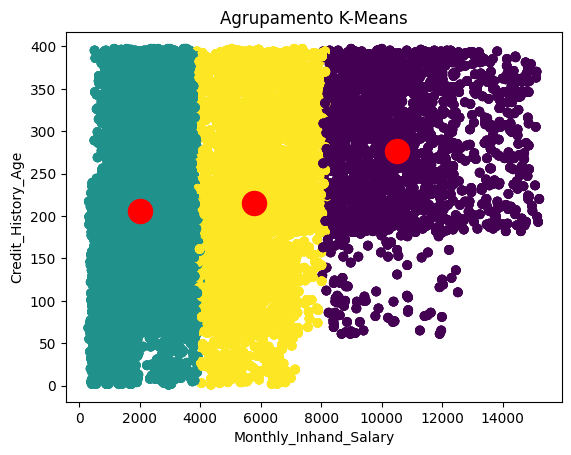

In [70]:
plt.scatter(X['Monthly_Inhand_Salary'], X['Credit_History_Age'], c=kmeans.labels_, cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='red')
plt.xlabel('Monthly_Inhand_Salary')
plt.ylabel('Credit_History_Age')
plt.title('Agrupamento K-Means')
plt.show()